# Experiment 2

# Table of Contents
1. [Libraries and Import data](#data)<br>
2. [Changing the network](#change)<br>
3. [Pre - Experiment 2](#pre2)<br>
4. [Post - Experiment 2](#post2)<br>


# 1. Libraries and Import Data <a name="data"></a>

In [1]:
import killing_agents as ka
import networkx as nx
import pickle
from geopy import distance
import pandas as pd
import numpy as np
from collections import defaultdict
import matplotlib.pyplot as plt
import math, copy
from functools import reduce
import resurrecting_agents as ra
import matplotlib
import matplotlib.patches as mpatches

In [2]:
G = nx.read_gpickle("data/G.gpickle")

In [3]:
coords_m4 = ka.coords.copy()
d_active_edges_ex2 = ka.d_active_edges.copy()

amenities = pd.read_csv("data/amenities.csv")
m4 = pd.read_csv("data/fermate_m4.csv", sep = "\t")
fermate_metro = pd.read_csv('data/tpl_metrofermate.csv', sep = ';')

# 2. Changing the network<a name="change"></a>

<div class="alert alert-success" >
In this section we apply changes to the network to add the Metro4 line. In G_ex2_pre we only add the stops, whereas in G_ex2_post we also include the new edges connecting them. In this way, in the pre-experiment the new nodes will be able to be included in the agents' schedules, while in the post-experiment the M4 becomes fully functional.

In [5]:
m4['Latitudine'] = m4['Latitudine'].str.replace(',', '.').astype(float)
m4['Longitudine'] = m4['Longitudine'].str.replace(',', '.').astype(float)

In [6]:
# Assign id to M4 stops
name_to_id = {}
i = 400
for f in m4.Fermata:
    name_to_id[f] = i
    i += 1

# Stops that are already present in the network and then already have an id
name_to_id['San Babila'] = 909
name_to_id['S. Ambrogio'] = 910


In [7]:
# Add id to the dataframe
m4['id'] = m4.Fermata.apply(lambda x: name_to_id[x])
m4.head()

,Fermata,Latitudine,Longitudine,id
0,Linate,45.462742,9.278566,400
1,Repetti,45.461877,9.240510,401
2,Forlanini FS,45.465978,9.236018,402
3,Argonne,45.468150,9.232101,403
4,Susa,45.468069,9.226724,404


In [8]:
# Add the coordinates of the new stops to the coords dictionary
for i in m4.id:
    coords_m4[i] = (m4[m4.id == i].iloc[0,2], m4[m4.id == i].iloc[0,1])

In [9]:
# Find all nodes that should be connected by foot edges (< 200m)
foot_edges_to_add = []
for i in ka.tqdm(m4.id):
    for j in ka.coords.keys():
        if i != j and distance.distance(coords_m4[i], coords_m4[j]).km <= 0.2:
            foot_edges_to_add.append((i,j))        

  0%|          | 0/21 [00:00<?, ?it/s]

In [10]:
# Find the amenities for the new M4 stops
am_counts_df_ex2 = ka.am_counts_df.copy()

am_counts_to_add = dict()
for i in ka.tqdm(m4.id):
    if i != 909 and i != 910:
        am = {'leisure': 0, 'food': 0, 'school': 0, 'office': 0}
        for j in range(amenities.shape[0]):
            if coords_m4[i][1] - amenities.iloc[j]['lat'] > 0.005:
                pass
            elif distance.distance(coords_m4[i], (amenities.iloc[j]['lon'], amenities.iloc[j]['lat'])).km <= 0.5:
                am[amenities.iloc[j]['category']] += 1
        am_counts_to_add[i] = am

am_counts_to_add_df = pd.DataFrame(am_counts_to_add).T

  0%|          | 0/21 [00:00<?, ?it/s]

In [11]:
am_counts_to_add_df = pd.DataFrame(am_counts_to_add).T

am_counts_to_add_df = am_counts_to_add_df.reset_index().rename(columns = {'index':'stops_id'}) 
am_counts_to_add_df = am_counts_to_add_df.rename(columns = {"leisure": "tempo libero",
                                                            "food": "dormire, mangiare e altra cura della persona",
                                                            "school":'istruzione e formazione', "office": 'lavoro retribuito'})

am_counts_ex2_df = pd.concat([am_counts_to_add_df, am_counts_df_ex2])

# Creating proportion dataframe for gen_agent function
tot_am = am_counts_df_ex2.sum(axis = 0) # total number of ways an amenity can be reached
am_counts_df_prob_ex2 = am_counts_df_ex2 / tot_am
am_counts_df_prob_ex2.head()

,stops_id,tempo libero,"dormire, mangiare e altra cura della persona",istruzione e formazione,lavoro retribuito
0,0.000015,0.000087,0.000021,0.0,0.000202
1,0.000014,0.000014,0.000021,0.0,0.000000
2,0.000016,0.000188,0.000149,0.0,0.000202
3,0.000014,0.000036,0.000032,0.0,0.000050
4,0.000015,0.000007,0.000032,0.0,0.000000


### Pre - Experiment Graph

In [12]:
# Creating graph with M4 stops but no edges
G_ex2_pre = copy.deepcopy(G)
G_ex2_pre.add_nodes_from([400,401,402,403,404,405,406,408,409,410,411,413,414,415,416,417,418,419,420])

In [13]:
# Adding foot edges to the graph
foot_ex2 = ka.foot.copy()
for i, j in foot_edges_to_add:
    if (i,j) not in G_ex2_pre.edges():
        G_ex2_pre.add_edge(i, j, key = 'foot', weight = distance.distance(coords_m4[i], coords_m4[j]).km/5, 
                        color = 'lightskyblue', trans_mode = 'foot', lines = 'foot', waiting_list=[], 
                        passengers_list=[], total_capacity=np.inf)
        foot_ex2.append((i,j,'foot'))
    if (j, i) not in G_ex2_pre.edges():
        G_ex2_pre.add_edge(j, i, key = 'foot', weight = distance.distance(coords_m4[i], coords_m4[j]).km/5,  
                        color = 'lightskyblue', trans_mode = 'foot', lines = 'foot', waiting_list=[], 
                        passengers_list=[], total_capacity=np.inf)
        foot_ex2.append((j, i,'foot'))

In [14]:
# Adding empty next edge attribute for foot edges
for i in foot_ex2:
    G_ex2_pre[i[0]][i[1]][i[2]]['next_edges'] = []

In [15]:
# Assigning the number of amenities to nodes
nx.set_node_attributes(G_ex2_pre, am_counts_to_add)

In [16]:
# Updating the dictionary of active edges
active_foot = [i for i in range(1440)]

for e in foot_ex2:
    d_active_edges_ex2[e] = active_foot

### Post - Experiment Graph

In [17]:
G_ex2_post = copy.deepcopy(G_ex2_pre)

In [18]:
# Creating a list of edges for both directions of Metro4
edges_m4_andata = []
for i in range(len(m4.id)-1):
    edges_m4_andata.append((m4.id.iloc[i], m4.id.iloc[i+1], 'METRO4'))
    
edges_m4_ritorno = []
for i in range(len(m4.Fermata)-1, 0, -1):
    edges_m4_ritorno.append((m4.id.iloc[i], m4.id.iloc[i-1], 'METRO4'))
    
edges_m4 = edges_m4_andata + edges_m4_ritorno

In [19]:
# Computing traveling time for each edge using distance and speed 
time = []
for e in edges_m4_andata:
    start = m4[m4.id == e[0]].iloc[0,1], m4[m4.id == e[0]].iloc[0,2]
    end = m4[m4.id == e[1]].iloc[0,1], m4[m4.id == e[1]].iloc[0,2]
    dist = distance.distance(start, end)
    tempo_percorrenza = (dist.km/32)*60
    time.append(math.ceil(tempo_percorrenza)) 
    
time_ritorno = time[::-1]
print(time,time_ritorno, sep = '\n')

[6, 2, 1, 1, 2, 2, 2, 2, 2, 1, 1, 1, 2, 1, 2, 1, 1, 2, 1, 1]
[1, 1, 2, 1, 1, 2, 1, 2, 1, 1, 1, 2, 2, 2, 2, 2, 1, 1, 2, 6]


In [20]:
# Retrieving timetables for M5 terminal stations, which is the most similar to M4, and assigning them to M4 terminal stations

capolinea1_m5 = np.array(sorted(ka.d_active_edges[(991,925,'METRO5')])) # from Bignami (M5)
capolinea2_m5 = np.array(sorted(ka.d_active_edges[(906,907,'METRO5')])) # from San Siro (M5)

In [21]:
# Computing timetable for all other edges of M4 starting from the terminal stations (Linate and San Cristoforo)

# from Linate (M4)
d_active_edges_ex2[edges_m4_andata[0]] = capolinea1_m5

for i in range(len(edges_m4_andata)-1):
    d_active_edges_ex2[edges_m4_andata[i+1]] = d_active_edges_ex2[edges_m4_andata[i]] + time[i]

# from San Cristoforo (M4)
d_active_edges_ex2[edges_m4_ritorno[0]] = capolinea2_m5

for i in range(len(edges_m4_ritorno)-1):
    d_active_edges_ex2[edges_m4_ritorno[i+1]] = d_active_edges_ex2[edges_m4_ritorno[i]] + time_ritorno[i]

In [22]:
# Transforming timetable from array to set

for e in edges_m4:
    d_active_edges_ex2[e] = set(d_active_edges_ex2[e])

In [23]:
# Building edges with all attributes and add them to graph

new_m4_edges = [(i[0],i[1],i[2], {'weight':distance.distance(coords_m4[i[0]], coords_m4[i[1]]).km/32,
                                     'trans_mode':4, 'color':'blue','lines': i[2], 'waiting_list':[], 
                                     'passengers_list':[], 'total_capacity':40}) for i in edges_m4]

G_ex2_post.add_edges_from(new_m4_edges);

In [24]:
# Storing the next edges in line of M4 edges

next_edges_m4 = {}
for i in range(len(edges_m4_andata)-1):
    next_edges_m4[edges_m4_andata[i]] = [edges_m4_andata[i+1]]
next_edges_m4[edges_m4_andata[-1]] = []

for i in range(len(edges_m4_ritorno)-1):
    next_edges_m4[edges_m4_ritorno[i]] = [edges_m4_ritorno[i+1]]
next_edges_m4[edges_m4_ritorno[-1]] = []

# Adding next edge attribute to M4 edges
for i in edges_m4:
    G_ex2_post[i[0]][i[1]][i[2]]['next_edges'] = next_edges_m4[i]

In [25]:
# Adding M4 routes to the percorsi dictionary

percorsi_ex2 = ka.percorsi.copy()
percorsi_ex2[4000] = edges_m4_andata
percorsi_ex2[4001] = edges_m4_ritorno

In [26]:
# Adding M4 routes to the orari dataframe by duplicating the ones of Metro5

orari_ex2 = ka.orari.copy()
m4_andata = orari_ex2.iloc[1091].copy()
m4_andata['linea'] = 4
m4_andata['percorso'] = 4000
m4_ritorno = orari_ex2.iloc[1134].copy()
m4_ritorno['linea'] = 4
m4_ritorno['percorso'] = 4001
orari_ex2 = pd.concat([orari_ex2, pd.DataFrame(m4_andata).T , pd.DataFrame(m4_ritorno).T])

In [27]:
# Adding a NIL for each new stop

fermate_nils_ex2 = ka.fermate_nils.copy()
fermate_nils_m4 = pd.read_csv('data/Fermate M4 nil.csv', sep = ';')
fermate_nils_m4 = pd.concat([fermate_nils_ex2, fermate_nils_ex2])

In [28]:
ka.plot_graph(G_ex2_pre, coords_m4)

In [29]:
ka.plot_graph(G_ex2_post, coords_m4)

# 3. Pre - Experiment 2<a name="pre2"></a>

<div class="alert alert-danger" >
Generating the agents takes 30h to run!

In [30]:
# generating 10 schedules for 25000 agents each
# for i in range(1,11):
#     dic, df = ka.gen_agent(25000)
#     file = open(f"pickle_ag2/schedule_{i}_ex2.pkl", "wb")
#     pickle.dump(dic, file)
#     file.close()

In [31]:
# generating 10 agents objects for 25000 agents each 
# for i in range(1,11):
#     file = open(f"pickle_ag2/schedule_{i}_ex2.pkl", "rb")
#     schedule = pickle.load(file)
#     file.close()
#     agents_obj = ka.gen_agents_objects(schedule, ka.percorsi, ka.foot, ka.orari, G)
#     file = open(f"pickle_ag2/schedule_{i}_object_ex2_pre.pkl", "wb")
#     pickle.dump(agents_obj, file)
#     file.close()

In [32]:
# running the initial simulation
simulations_pre_ex2 = []
agents_list_pre_ex2 = []
history_pre_ex2 = []
traveling_on_edge_pre_ex2 =[]     # max number of passengers per edge
traveling_on_edge_set_pre_ex2 =[] # different people that pass on one edge
moving_agents_pre_ex2 = []        
daily_passengers_pre_ex2 = []
daily_waiters_pre_ex2 = []
full_edges_pre_ex2 = []

for i in range(1,11):
    G_reset = copy.deepcopy(G_ex2_pre)
    simulation = ka.simulation(G= G_reset, import_agents_ob=f'pickle_ag2/schedule_{i}_object_ex2_pre.pkl',
                               foot = foot_ex2, d_active_edges=d_active_edges_ex2)
    simulations_pre_ex2.append(simulation)
    agents_list_pre_ex2.append(simulation[0])
    history_pre_ex2.append(simulation[1])
    traveling_on_edge_pre_ex2.append(simulation[2])     
    traveling_on_edge_set_pre_ex2.append(simulation[3]) 
    moving_agents_pre_ex2.append(simulation[4])       
    daily_passengers_pre_ex2.append(simulation[5])
    daily_waiters_pre_ex2.append(simulation[6])
    full_edges_pre_ex2.append(simulation[7])

Imported 20483 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20482 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20448 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20417 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20375 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20480 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20380 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20411 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20418 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20431 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!


### Results simulation pre - experiment 2 on all groups

In [33]:
tot_traveling_on_edge_pre_ex2 = {}
for i in traveling_on_edge_pre_ex2:
    for j in i:
        tot_traveling_on_edge_pre_ex2[j] = tot_traveling_on_edge_pre_ex2.get(j,0) + i[j]
        
tot_traveling_on_edge_set_pre_ex2 = {}
for i in traveling_on_edge_set_pre_ex2:
    for j in i:
        tot_traveling_on_edge_set_pre_ex2[j] = tot_traveling_on_edge_set_pre_ex2.get(j,0) + i[j]
        
tot_daily_waiters_pre_ex2 = {}
for i in daily_waiters_pre_ex2:
    for j in i:
        tot_daily_waiters_pre_ex2[j] = tot_daily_waiters_pre_ex2.get(j,0) + i[j]

In [34]:
# Total plot
ka.density_graph_plot(tot_traveling_on_edge_pre_ex2,tot_traveling_on_edge_set_pre_ex2,
                    tot_daily_waiters_pre_ex2, G_ex2_pre, coords_m4)

# 4. Post - experiment 2<a name="post2"></a>

In [35]:
# running the post simulation
simulations_post_ex2 = []
agents_list_post_ex2 = []
history_post_ex2 = []
traveling_on_edge_post_ex2 =[]     # max number of passengers per edge
traveling_on_edge_set_post_ex2 =[] # different people that pass on one edge
moving_agents_post_ex2 = []        
daily_passengers_post_ex2 = []
daily_waiters_post_ex2 = []
full_edges_post_ex2 = []

for i in range(1,11):
    G_reset = copy.deepcopy(G_ex2_post)
    simulation = ka.simulation(G= G_reset, import_agents_ob=f'pickle_ag2/schedule_{i}_object_ex2.pkl', 
                              percorsi = percorsi_ex2, d_active_edges = d_active_edges_ex2, orari=orari_ex2, foot=foot_ex2)
    simulations_post_ex2.append(simulation)
    agents_list_post_ex2.append(simulation[0])
    history_post_ex2.append(simulation[1])
    traveling_on_edge_post_ex2.append(simulation[2])     
    traveling_on_edge_set_post_ex2.append(simulation[3]) 
    moving_agents_post_ex2.append(simulation[4])       
    daily_passengers_post_ex2.append(simulation[5])
    daily_waiters_post_ex2.append(simulation[6])
    full_edges_post_ex2.append(simulation[7])

Imported 20483 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20482 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20448 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20417 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20375 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20480 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20380 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20411 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20418 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!
Imported 20431 agents objects
Running the simulation:


  0%|          | 0/1200 [00:00<?, ?it/s]

Simulation completed successfully!


### Results of post - experiment 2 on all groups

In [36]:
tot_traveling_on_edge_post_ex2 = {}
for i in traveling_on_edge_post_ex2:
    for j in i:
        tot_traveling_on_edge_post_ex2[j] = tot_traveling_on_edge_post_ex2.get(j,0) + i[j]

tot_traveling_on_edge_set_post_ex2 = {}
for i in traveling_on_edge_set_post_ex2:
    for j in i:
        tot_traveling_on_edge_set_post_ex2[j] = tot_traveling_on_edge_set_post_ex2.get(j,0) + i[j]

tot_daily_waiters_post_ex2 = {}
for i in daily_waiters_post_ex2:
    for j in i:
        tot_daily_waiters_post_ex2[j] = tot_daily_waiters_post_ex2.get(j,0) + i[j]

In [37]:
# Total plot
ka.density_graph_plot(tot_traveling_on_edge_post_ex2,tot_traveling_on_edge_set_post_ex2,
                    tot_daily_waiters_post_ex2, G_ex2_post, coords_m4)

# Comparing Pre and Post Experiment

We test some effects of the intervention both on the entire population:
More precisely we compare before and after the intervention:
- Average waiting and traveling time for all agents;
- The percentage of traveling and waiting agents over time;
- Number of minutes edges are at full capacity;
- Number of vehicle changes for all agents;
- Number of times all agents need to move on foot;
- Number of passengers per vehicle;
- Most frequented stops;
- Most crossed edges;
- Distance-adjusted time-per-trip distribution for all agents.


In [66]:
# total summary stats pre experiment
average_waiting_time_pre_ex2 = []
average_traveling_time_pre_ex2 = []
average_number_activities_pre_ex2 = []

for agent in agents_list_pre_ex2:
    summary_stats = ka.summary_stats(agent, sum_print = False)
    average_waiting_time_pre_ex2.append(summary_stats[2])
    average_traveling_time_pre_ex2.append(summary_stats[3])
    average_number_activities_pre_ex2.append(summary_stats[4])
    
mean_waiting_pre_ex2 = np.mean(average_waiting_time_pre_ex2)
std_waiting_pre_ex2 = np.std(average_waiting_time_pre_ex2)

mean_waiting_dest_pre_ex2 = np.mean(np.array(average_waiting_time_pre_ex2)/np.array(average_number_activities_pre_ex2))
std_waiting_dest_pre_ex2 = np.std(np.array(average_waiting_time_pre_ex2)/np.array(average_number_activities_pre_ex2))

mean_traveling_pre_ex2 = np.mean(average_traveling_time_pre_ex2)
std_traveling_pre_ex2 = np.std(average_traveling_time_pre_ex2)

mean_traveling_dest_pre_ex2 = np.mean(np.array(average_traveling_time_pre_ex2)/np.array(average_number_activities_pre_ex2))
std_traveling_dest_pre_ex2 = np.std(np.array(average_traveling_time_pre_ex2)/np.array(average_number_activities_pre_ex2))

In [67]:
# total summary stats for post experiment
average_waiting_time_post_ex2 = []
average_traveling_time_post_ex2 = []
average_number_activities_post_ex2 = []

for agent in agents_list_post_ex2:
    summary_stats = ka.summary_stats(agent, sum_print = False)
    average_waiting_time_post_ex2.append(summary_stats[2])
    average_traveling_time_post_ex2.append(summary_stats[3])
    average_number_activities_post_ex2.append(summary_stats[4])
    
mean_waiting_post_ex2 = np.mean(average_waiting_time_post_ex2)
std_waiting_post_ex2 = np.std(average_waiting_time_post_ex2)

mean_waiting_dest_post_ex2 = np.mean(np.array(average_waiting_time_post_ex2)/np.array(average_number_activities_post_ex2))
std_waiting_dest_post_ex2 = np.std(np.array(average_waiting_time_post_ex2)/np.array(average_number_activities_post_ex2))

mean_traveling_post_ex2 = np.mean(average_traveling_time_post_ex2)
std_traveling_post_ex2 = np.std(average_traveling_time_post_ex2)

mean_traveling_dest_post_ex2 = np.mean(np.array(average_traveling_time_post_ex2)/np.array(average_number_activities_post_ex2))
std_traveling_dest_post_ex2 = np.std(np.array(average_traveling_time_post_ex2)/np.array(average_number_activities_post_ex2))

In [68]:
print("Considering all the agents:")
print()
print("Mean Waiting Time:\n- Pre-Experiment:", round(mean_waiting_pre_ex2,2)," - Standard Deviation:", round(std_waiting_pre_ex2,2))
print("- Post-Experiment:", round(mean_waiting_post_ex2,2)," - Standard Deviation:", round(std_waiting_post_ex2,2))
print()
print("Mean Waiting Time per trip:\n- Pre-Experiment", round(mean_waiting_dest_pre_ex2,2)," - Standard Deviation:",round(std_waiting_dest_pre_ex2,2))
print("- Post-Experiment", round(mean_waiting_dest_post_ex2,2)," - Standard Deviation:",round(std_waiting_dest_post_ex2,2))
print()
print("Mean Traveling Time:\n- Pre-Experiment:", round(mean_traveling_pre_ex2,2)," - Standard Deviation:", round(std_traveling_pre_ex2,2))
print("- Post-Experiment:", round(mean_traveling_post_ex2,2)," - Standard Deviation:", round(std_traveling_post_ex2,2))
print()
print("Mean Traveling Time per trip:\n- Pre-Experiment", round(mean_traveling_dest_pre_ex2,2)," - Standard Deviation:",round(std_traveling_dest_pre_ex2,2))
print("- Post-Experiment", round(mean_traveling_dest_post_ex2,2)," - Standard Deviation:",round(std_traveling_dest_post_ex2,2))

Considering all the agents:

Mean Waiting Time:
- Pre-Experiment: 37.27  - Standard Deviation: 0.3
- Post-Experiment: 33.61  - Standard Deviation: 0.36

Mean Waiting Time per trip:
- Pre-Experiment 17.66  - Standard Deviation: 0.13
- Post-Experiment 15.93  - Standard Deviation: 0.16

Mean Traveling Time:
- Pre-Experiment: 53.13  - Standard Deviation: 0.4
- Post-Experiment: 50.4  - Standard Deviation: 0.39

Mean Traveling Time per trip:
- Pre-Experiment 25.18  - Standard Deviation: 0.15
- Post-Experiment 23.88  - Standard Deviation: 0.14


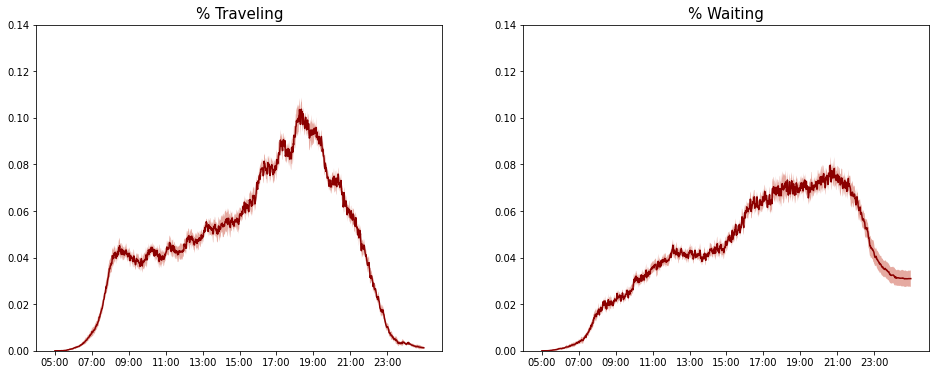

In [40]:
# aggregated time series waiting and traveling ag PRE
ka.agg_moving_ts_plot(moving_agents_pre_ex2)

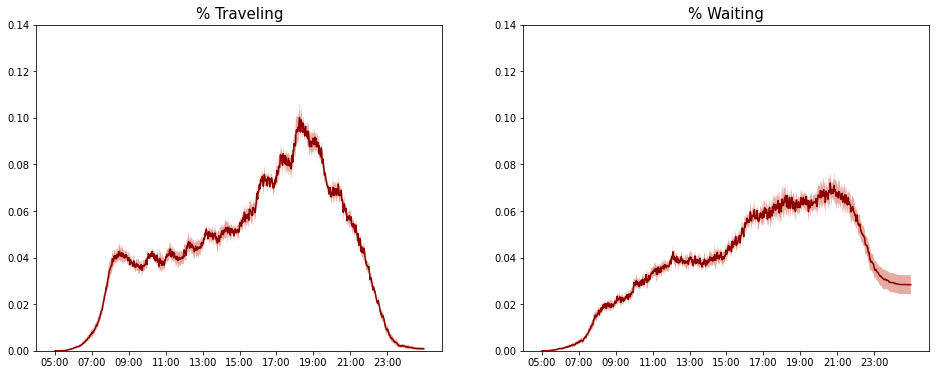

In [41]:
# aggregated time series waiting and traveling ag POST
ka.agg_moving_ts_plot(moving_agents_post_ex2)

As it can be observed from the previously shown outputs, the introduction of the new metro line has a positive effect on the efficiency of the network by reducing the mean traveling and waiting times, both overall and per trip.

In [73]:
# return aggregate measure for the full_edges function across simulations PRE
"""
Returns a df sorted by total number of minutes each edge reached full capacity.
"""

full_edges_agg_pre = [ka.full_edges_df(dict_).rename(columns ={"Full Minutes": i}) for i,dict_ in enumerate(full_edges_pre_ex2)]
full_edges_agg_pre = reduce(lambda left,right: pd.merge(left, right, left_index = True, right_index = True, how = "outer"), full_edges_agg_pre).fillna(0)
mean_ = full_edges_agg_pre.mean(axis=1)
std_ = full_edges_agg_pre.std(axis=1)
min_ = full_edges_agg_pre.min(axis=1)
max_ = full_edges_agg_pre.max(axis=1)
median_ = full_edges_agg_pre.quantile(axis=1)
full_edges_agg_pre["mean"] = mean_
full_edges_agg_pre["std"] = std_
full_edges_agg_pre["min"] = min_
full_edges_agg_pre["max"] = max_
full_edges_agg_pre["median"] = median_
full_edges_agg_pre = full_edges_agg_pre[["mean", "std", "min", "max", "median"]].sort_values("mean", ascending = False)

In [74]:
# return aggregate measure for the full_edges function across simulations POST
"""
Returns a df sorted by total number of minutes each edge reached full capacity.
"""

full_edges_agg_post = [ka.full_edges_df(dict_).rename(columns ={"Full Minutes": i}) for i,dict_ in enumerate(full_edges_post_ex2)]
full_edges_agg_post = reduce(lambda left,right: pd.merge(left, right, left_index = True, right_index = True, how = "outer"), full_edges_agg_post).fillna(0)
mean_ = full_edges_agg_post.mean(axis=1)
std_ = full_edges_agg_post.std(axis=1)
min_ = full_edges_agg_post.min(axis=1)
max_ = full_edges_agg_post.max(axis=1)
median_ = full_edges_agg_post.quantile(axis=1)
full_edges_agg_post["mean"] = mean_
full_edges_agg_post["std"] = std_
full_edges_agg_post["min"] = min_
full_edges_agg_post["max"] = max_
full_edges_agg_post["median"] = median_
full_edges_agg_post = full_edges_agg_post[["mean", "std", "min", "max", "median"]].sort_values("mean", ascending = False)

In [75]:
# show the differences in number of passengers (vehicle usage) pre vs post experiment
full_edges_agg_diff = pd.merge(full_edges_agg_post[["mean"]].rename(columns = {"mean": "mean_post"}),
                                      full_edges_agg_pre[["mean"]].rename(columns = {"mean": "mean_pre"}),
                                      left_index = True, right_index = True, how = "outer")
full_edges_agg_diff["diff"] = full_edges_agg_diff["mean_post"] -  full_edges_agg_diff["mean_pre"]
full_edges_agg_diff["% change"] = (full_edges_agg_diff["mean_post"] -  full_edges_agg_diff["mean_pre"])/ full_edges_agg_diff["mean_pre"]
full_edges_agg_diff["% change"] = full_edges_agg_diff["% change"].apply(lambda x: round(x*100,1))
top_10_full = full_edges_agg_diff.sort_values("% change", ascending = False).head(10)
bottom_10_full = full_edges_agg_diff.sort_values("% change", ascending = True).head(10)

In [76]:
ka.display_side_by_side(top_10_full, bottom_10_full)

,mean_post,mean_pre,diff,% change
"(10549, 10551, BUS98)",10.8,0.2,10.6,5300.0
"(17389, 17390, FILOBUS92)",2.3,0.1,2.2,2200.0
"(16476, 16477, BUS560)",0.6,0.1,0.5,500.0
"(16478, 16479, BUS560)",0.6,0.1,0.5,500.0
"(16479, 16453, BUS560)",1.2,0.3,0.9,300.0
"(16474, 16475, BUS560)",0.4,0.1,0.3,300.0
"(14332, 14333, BUS327)",0.3,0.1,0.2,200.0
"(16477, 16478, BUS560)",0.6,0.2,0.4,200.0
"(16475, 16476, BUS560)",0.6,0.2,0.4,200.0
"(11690, 11688, BUS166)",0.3,0.1,0.2,200.0


In [108]:
ka.plot_lines_graph(G_ex2_post, coords_m4, single_lines= ['METRO4'], edges=list(bottom_10_full.index))

In [104]:
ka.plot_lines_graph(G_ex2_post, coords_m4, single_lines= ['METRO4'], edges=list(top_10_full.index))

Following the activation of the metro line 4, two edges belonging to BUS line 98 and FILOBUS line 92 experience the most growth in total minutes at full capacity. This result suggests that the intervention is likely to overload the two surface lines nearby metro line 4 stops. 

In [112]:
# returns vehicle_changes across simulations PRE on all agents
"""
Computing the average number of vehicle changes for a given list of agent objects.
"""

agg_vehicle_changes_pre = []

for agent_list in agents_list_pre_ex2:
    mean = ka.vehicle_changes(agent_list) 
    agg_vehicle_changes_pre.append(mean)
    
agg_mean_vehicle_changes_pre = np.mean(agg_vehicle_changes_pre)
agg_std_vehicle_changes_pre = np.std(agg_vehicle_changes_pre)


In [113]:
# returns vehicle_changes across simulations POST on all agents
"""
Computing the average number of vehicle changes for a given list of agent objects.
"""

agg_vehicle_changes_post = []

for agent_list in agents_list_post_ex2:
    mean = ka.vehicle_changes(agent_list) 
    agg_vehicle_changes_post.append(mean)
    
agg_mean_vehicle_changes_post = np.mean(agg_vehicle_changes_post)
agg_std_vehicle_changes_post = np.std(agg_vehicle_changes_post)


In [114]:
print("Considering all the agents:")
print()
print("Mean Number of Vehicle Changes:\n- Pre-Experiment:",agg_mean_vehicle_changes_pre,'- Standard deviation:',agg_std_vehicle_changes_pre)
print("- Pre-Experiment:",agg_mean_vehicle_changes_post,'- Standard deviation:',agg_std_vehicle_changes_post)

Considering all the agents:

Mean Number of Vehicle Changes:
- Pre-Experiment: 8.063154917752529 - Standard deviation: 0.056391528243732884
- Pre-Experiment: 8.076462463055805 - Standard deviation: 0.05241689746655955


In [116]:
# returns foot_route across simulations PRE on all agents
"""
Returns average number of times agents move on foot.
"""

agg_foot_route_pre = []

for agent_list in agents_list_pre_ex2:
    mean = ka.foot_route(agent_list)
    agg_foot_route_pre.append(mean)
    
agg_mean_foot_route_pre = np.mean(agg_foot_route_pre)
agg_std_agg_foot_route_pre = np.std(agg_foot_route_pre)

In [117]:
# returns foot_route across simulations POST on all agents
"""
Returns average number of times agents move on foot.
"""

agg_foot_route_post = []

for agent_list in agents_list_post_ex2:
    mean = ka.foot_route(agent_list)
    agg_foot_route_post.append(mean)
    
agg_mean_foot_route_post = np.mean(agg_foot_route_post)
agg_std_agg_foot_route_post = np.std(agg_foot_route_post)

In [115]:
print("Considering all the agents:")
print()
print("Mean Number of times agents need to move on foot:\n- Pre-Experiment:",agg_mean_foot_route_pre,'- Standard deviation:',agg_std_agg_foot_route_pre)
print("- Post-Experiment:",agg_mean_foot_route_post,'- Standard deviation:',agg_std_agg_foot_route_post)

Considering all the agents:

Mean Number of times agents need to move on foot:
- Pre-Experiment: 6.416969798831292 - Standard deviation: 0.037851216982440594
- Post-Experiment: 6.198878126180757 - Standard deviation: 0.03864696897416987


In [118]:
# vehicle usage across simulations and all agents PRE
"""
Returns total number of passengers for each vehicle.
"""

vehicle_usage_agg = [ka.vehicle_usage(agent_list).rename(columns = {"Total Passengers": i}) for i,agent_list in enumerate(agents_list_pre_ex2)]
vehicle_usage_agg = reduce(lambda left,right: pd.merge(left, right, left_index = True, right_index = True, how = "outer"), vehicle_usage_agg).fillna(0)
mean_ = vehicle_usage_agg.mean(axis=1)
std_= vehicle_usage_agg.std(axis=1)
min_ = vehicle_usage_agg.min(axis=1)
max_ = vehicle_usage_agg.max(axis=1)
median_ = vehicle_usage_agg.quantile(axis=1)
vehicle_usage_agg["mean"] = mean_
vehicle_usage_agg["std"] = std_
vehicle_usage_agg["min"] = min_
vehicle_usage_agg["max"] = max_
vehicle_usage_agg["median"] = median_
vehicle_usage_agg = vehicle_usage_agg[["mean", "std", "min", "max", "median"]].sort_values("mean", ascending = False)

In [119]:
# vehicle usage across simulations and all agents POST
# agents_list_post_ex2
                                                                                                                                
vehicle_usage_agg_post = [ka.vehicle_usage(agent_list).rename(columns = {"Total Passengers": i}) for i,agent_list in enumerate(agents_list_post_ex2)]
vehicle_usage_agg_post = reduce(lambda left,right: pd.merge(left, right, left_index = True, right_index = True, how = "outer"), vehicle_usage_agg_post).fillna(0)
mean_ = vehicle_usage_agg_post.mean(axis=1)
std_= vehicle_usage_agg_post.std(axis=1)
min_ = vehicle_usage_agg_post.min(axis=1)
max_ = vehicle_usage_agg_post.max(axis=1)
median_ = vehicle_usage_agg_post.quantile(axis=1)
vehicle_usage_agg_post["mean"] = mean_
vehicle_usage_agg_post["std"] = std_
vehicle_usage_agg_post["min"] = min_
vehicle_usage_agg_post["max"] = max_
vehicle_usage_agg_post["median"] = median_
vehicle_usage_agg_post = vehicle_usage_agg_post[["mean", "std", "min", "max", "median"]].sort_values("mean", ascending = False)

In [52]:
# show the differences in number of passengers (vehicle usage) pre vs post experiment
vehicle_usage_diff = pd.merge(vehicle_usage_agg_post[["mean"]].rename(columns = {"mean": "mean_post"}),
                                      vehicle_usage_agg[["mean"]].rename(columns = {"mean": "mean_pre"}),
                                      left_index = True, right_index = True, how = "outer")
vehicle_usage_diff["diff"] = vehicle_usage_diff["mean_post"] -  vehicle_usage_diff["mean_pre"]
vehicle_usage_diff["% change"] = (vehicle_usage_diff["mean_post"] -  vehicle_usage_diff["mean_pre"])/ vehicle_usage_diff["mean_pre"]
vehicle_usage_diff["% change"] = vehicle_usage_diff["% change"].apply(lambda x: round(x*100,1))
top_5_usage = vehicle_usage_diff.sort_values("% change", ascending = False).head(5)
bottom_5_usage = vehicle_usage_diff.sort_values("% change", ascending = True).head(5)

In [133]:
vehicle_usage_agg_post.head()

,mean,std,min,max,median
METRO1,80988.3,1246.483324,78712.0,83726.0,80698.5
METRO2,69076.6,766.737997,68160.0,70338.0,68874.0
METRO3,50714.5,988.236729,49019.0,52456.0,50473.5
METRO4,34594.9,571.705723,33302.0,35141.0,34715.0
METRO5,33546.5,393.717679,32900.0,34193.0,33505.5


Metro 4 is the fourth most used line in terms of average daily number of passengers. We then check which lines are the most impacted by the change of the network:

In [148]:
ka.display_side_by_side(top_5_usage, bottom_5_usage)

,mean_post,mean_pre,diff,% change
BUS65,2437.8,2116.6,321.2,15.2
BUS926,32.2,28.5,3.7,13.0
BUS327,1522.9,1377.5,145.4,10.6
BUS351,742.6,679.1,63.5,9.4
BUS353,45.3,42.8,2.5,5.8
,mean_post,mean_pre,diff,% change
BUS54,1786.1,4594.4,-2808.3,-61.1
BUS45,2574.2,5176.2,-2602.0,-50.3
BUS49,2136.7,3680.8,-1544.1,-42.0
BUS322,848.0,1445.3,-597.3,-41.3


In [131]:
ka.plot_lines_graph(G_ex2_post, coords_m4, single_lines= ['METRO4'], lines_group1= list(top_5_usage.index), lines_group2 = list(bottom_5_usage.index))

The graph above shows in pink the lines, like BUS 73 and 45, for which there is the highest decrease in average number of passengers during the day, meaning that they are probably substituted by the newly activated metro 4, which, in fact, lies in the neighborhood of their routes.
On the other hand, the graph shows in green the lines whose average number of passengers increases the most after the intervention, suggesting the metro 4 may incentivise the use of lines such as BUS 65 and 351.

In [54]:
# hotspots across different simulations pre exp
                                                                                              
n_hotspots_pre_agg = [ka.n_hotspots(20,df)[["id_amat","daily_waiters"]].rename(columns ={"daily_waiters": i}) for i, df in enumerate(daily_waiters_pre_ex2)]
n_hotspots_pre_agg = reduce(lambda left,right: pd.merge(left, right, left_on = "id_amat", right_on = "id_amat", how = "outer"), n_hotspots_pre_agg).fillna(0)
                                                      
mean_ = n_hotspots_pre_agg.loc[:,[i for i in range(len(daily_waiters_pre_ex2))]].mean(axis = 1)
n_hotspots_pre_agg["mean"] = mean_
n_hotspots_pre_agg = n_hotspots_pre_agg[["id_amat","mean"]].sort_values("mean", ascending = False).rename(columns= {"nome_x": "name"})
n_hotspots_pre_agg = pd.merge(n_hotspots_pre_agg, ka.fermate).rename(columns ={"nome": "name"})[["id_amat", "name","mean"]]

In [55]:
# hotspots across different simulations pre exp
                                                                                              
n_hotspots_post_agg = [ka.n_hotspots(20,df)[["id_amat","daily_waiters"]].rename(columns ={"daily_waiters": i}) for i, df in enumerate(daily_waiters_post_ex2)]
n_hotspots_post_agg = reduce(lambda left,right: pd.merge(left, right, left_on = "id_amat", right_on = "id_amat", how = "outer"), n_hotspots_post_agg).fillna(0)
                                                      
mean_ = n_hotspots_post_agg.loc[:,[i for i in range(len(daily_waiters_post_ex2))]].mean(axis = 1)
n_hotspots_post_agg["mean"] = mean_
n_hotspots_post_agg = n_hotspots_post_agg[["id_amat","mean"]].sort_values("mean", ascending = False).rename(columns= {"nome_x": "name"})
n_hotspots_post_agg = pd.merge(n_hotspots_post_agg, ka.fermate).rename(columns ={"nome": "name"})[["id_amat", "name","mean"]]

In [56]:
ka.display_side_by_side(n_hotspots_pre_agg.head(15), n_hotspots_post_agg.head(15))

,id_amat,name,mean
0,985,CADORNA FN M1,5901.0
1,956,GARIBALDI FS,5771.7
2,984,CADORNA FN M2,5625.0
3,975,CENTRALE FS,4519.5
4,890,ZARA,4188.1
5,959,DUOMO M3,3948.2
6,960,DUOMO M1,3512.9
7,930,PAGANO,2596.3
8,990,BISCEGLIE,1851.5
9,937,MACIACHINI,1801.7


We checked the 15 most crowded stops before and after the experiment: as we can see above, both "San Babila" and "S. Ambrogio", which are the stops that the new line shares with Metro 1 and Metro 2 respectively, experience an increase in traffic.

In [57]:
# hotedges across different simulations pre exp
                                                                                              
n_hotedges_pre_agg = [ka.n_hotedges(20, df).rename(columns ={"daily_passengers": i}) for i, df in enumerate(daily_passengers_pre_ex2)]

for i, df in enumerate(n_hotedges_pre_agg):
    df["edge"] = df.apply(lambda x: f"{x['from']} {x['to']} {x['line']}", axis = 1)
    n_hotedges_pre_agg[i] = df[[i, "edge"]]

n_hotedges_pre_agg = reduce(lambda left,right: pd.merge(left, right, left_on = "edge", right_on = "edge", how = "outer"), n_hotedges_pre_agg).fillna(0)

mean_ = n_hotedges_pre_agg.loc[:,[i for i in range(len(daily_passengers_pre_ex2))]].mean(axis = 1)
n_hotedges_pre_agg["mean"] = mean_
n_hotedges_pre_agg = n_hotedges_pre_agg[["edge","mean"]]
n_hotedges_pre_agg["from"] = n_hotedges_pre_agg["edge"].apply(lambda x: int(x.split(" ")[0]))
n_hotedges_pre_agg["to"] = n_hotedges_pre_agg["edge"].apply(lambda x: int(x.split(" ")[1]))
n_hotedges_pre_agg["line"] = n_hotedges_pre_agg["edge"].apply(lambda x: x.split(" ")[2])
n_hotedges_pre_agg = pd.merge(n_hotedges_pre_agg, ka.fermate, left_on = "from", right_on = "id_amat")[['edge','nome','to','mean']].rename(columns = {'nome':'from'})
n_hotedges_pre_agg = pd.merge(n_hotedges_pre_agg, ka.fermate, left_on = "to", right_on = "id_amat")[['edge','from','nome','mean']].rename(columns = {'nome':'to'})

In [58]:
# hotedges across different simulations post exp
                                                                                              
n_hotedges_post_agg = [ka.n_hotedges(20, df).rename(columns ={"daily_passengers": i}) for i, df in enumerate(daily_passengers_post_ex2)]

for i, df in enumerate(n_hotedges_post_agg):
    df["edge"] = df.apply(lambda x: f"{x['from']} {x['to']} {x['line']}", axis = 1)
    n_hotedges_post_agg[i] = df[[i, "edge"]]

n_hotedges_post_agg = reduce(lambda left,right: pd.merge(left, right, left_on = "edge", right_on = "edge", how = "outer"), n_hotedges_post_agg).fillna(0)

mean_ = n_hotedges_post_agg.loc[:,[i for i in range(len(daily_passengers_post_ex2))]].mean(axis = 1)
n_hotedges_post_agg["mean"] = mean_
n_hotedges_post_agg = n_hotedges_post_agg[["edge","mean"]]
n_hotedges_post_agg["from"] = n_hotedges_post_agg["edge"].apply(lambda x: int(x.split(" ")[0]))
n_hotedges_post_agg["to"] = n_hotedges_post_agg["edge"].apply(lambda x: int(x.split(" ")[1]))
n_hotedges_post_agg["line"] = n_hotedges_post_agg["edge"].apply(lambda x: x.split(" ")[2])
n_hotedges_post_agg = pd.merge(n_hotedges_post_agg, ka.fermate, left_on = "from", right_on = "id_amat")[['edge','nome','to','mean']].rename(columns = {'nome':'from'})
n_hotedges_post_agg = pd.merge(n_hotedges_post_agg, ka.fermate, left_on = "to", right_on = "id_amat")[['edge','from','nome','mean']].rename(columns = {'nome':'to'})

In [59]:
ka.display_side_by_side(n_hotedges_pre_agg.head(10), n_hotedges_post_agg.head(10))

,edge,from,to,mean
0,968 985 METRO1,CONCILIAZIONE,CADORNA FN M1,3726.3
1,981 985 METRO1,CAIROLI,CADORNA FN M1,3100.5
2,968 930 METRO1,CONCILIAZIONE,PAGANO,3225.0
3,981 967 METRO1,CAIROLI,CORDUSIO,3221.9
4,960 967 METRO1,DUOMO M1,CORDUSIO,3024.6
5,985 968 METRO1,CADORNA FN M1,CONCILIAZIONE,3608.0
6,930 968 METRO1,PAGANO,CONCILIAZIONE,3400.6
7,985 981 METRO1,CADORNA FN M1,CAIROLI,3164.7
8,967 981 METRO1,CORDUSIO,CAIROLI,3207.9
9,967 960 METRO1,CORDUSIO,DUOMO M1,2966.9


In [142]:
# distance-adjusted times across different simulations PRE exp

time_distribution_pre_ex2 = []

for history_ in history_pre_ex2:
    time_distribution_pre_ex2 = np.concatenate([time_distribution_pre_ex2, ka.time_distance_distribution(history_, G_ex2_pre)[0]])
    
# plt.hist(time_distribution_pre_ex2, bins = 30, density = True)
# plt.xticks([i for i in range(int(max(time_distribution_pre_ex2)+1))])
# plt.xlabel('min/km')
# plt.ylabel('density')
# plt.title('Distance adjusted distribution of time-per-destination')
# plt.show()

In [143]:
# distance-adjusted times across different simulations POST exp

time_distribution_post_ex2 = []

for history_ in history_post_ex2:
    time_distribution_post_ex2 = np.concatenate([time_distribution_post_ex2, ka.time_distance_distribution(history_, G_ex2_post)[0]])
    
# plt.hist(time_distribution_post_ex2, bins = 30, density = True)
# plt.xticks([i for i in range(int(max(time_distribution_post_ex2)+1))])
# plt.xlabel('min/km')
# plt.ylabel('density')
# plt.title('Distance adjusted distribution of time-per-destination')
# plt.show()

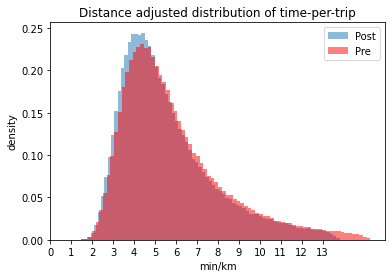

In [147]:
plt.hist(time_distribution_post_ex2, bins = 80, density = True, alpha = 0.5, label = 'Post')
plt.hist(time_distribution_pre_ex2, bins = 80, density = True, alpha = 0.5, color = 'red', label = 'Pre')
plt.xticks([i for i in range(int(max(time_distribution_post_ex2)+1))])
plt.xlabel('min/km')
plt.ylabel('density')
plt.title('Distance adjusted distribution of time-per-trip')
plt.legend()
plt.show()

The above plot shows the distributions of time-per-destination adjusted for the distance of the trip. 
The distribution after the intervention is slightly more skewed to the right, implying that agents manage to traverse the network more rapidly.